In [1]:
from PIL import Image
import h5py
import anubisPlotUtils as anPlot
import json
import numpy as np
import os
import hist as hi
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
matplotlib.use('TkAgg')  # or 'Qt5Agg', 'GTK3Agg', etc.
import mplhep as hep
hep.style.use([hep.style.ATLAS])
import sys
import ANUBIS_triggered_functions as ANT
import pandas as pd
import matplotlib.backends.backend_pdf
from matplotlib.ticker import MultipleLocator
import plotly
import plotly.graph_objs as go
import plotly.express as px


%matplotlib inline

In [2]:
def check_event_attributes_by_RPC(event,min_chamber_number,min_RPC_number,RPC_excluded):
    #Used in filter_events() function to decide whether or not to save an event as described by the user's inputs.
    #The user selects an RPC to exclude from the filter. 
    #e.g. say we want to exclude RPC 4 and the user selects a min_RPC_number of 4. The check_event_...() will check if the
    #event has atleast 4 RPCs hit.

    #USING ONLY ETA FILTER HERE SINCE THIS IS WHAT TRIGGERS THE CHANNEL!

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]

    RPC_counter = 0
    chamber_counter = 0
    condition_1 = False
    condition_2 = False
    condition_3 = False

    for RPC in range(6):

        if RPC ==  RPC_excluded:
            pass
        else:
            if RPC<3:
                #Checking triplet layer.
                if event[2][RPC][1]:
                    #Reqiure atleast one eta strip to go off
                    RPC_counter+=1 
                    #If RPC has two eta and phi strips going off then consider it "hit"
                    if not condition_1:
                        #Count triplet chamber being hit.
                        chamber_counter+=1
                        condition_1 = True
            elif RPC == 3:
                #Singlet layer
                if event[2][RPC][1]:
                    RPC_counter+=1
                    if not condition_2:
                        chamber_counter+=1
                        condition_2 = True
            else:
                #Doublet layer
                if event[2][RPC][1]:
                    RPC_counter+=1
                    if not condition_3:
                        chamber_counter+=1
                        condition_3 = True
    return RPC_counter >= min_RPC_number and chamber_counter >= min_chamber_number

def filter_events_by_RPC(events,min_chamber_number,min_RPC_number,RPC_excluded):
    #Initiliase array of filtered events
    filtered_events = []

    for event in events:
        if check_event_attributes_by_RPC(event,min_chamber_number,min_RPC_number,RPC_excluded):
            filtered_events.append(event)

   # print(f"Number of events in filter = {len(filtered_events)}")
    
    return filtered_events

def reconstruct_timed_byRPC(event,max_cluster_size,RPC_excluded):

    #timed tag indicates that timing information from RPC is used to determine direction of vertical transversal of "particle" in the event.

    max_residual = 100

    # event = ['Event x',TIMEBIN, [[[RPC1_PHI_CLUSTERS],[RPC1_ETA_CLUSTERS]],[[...],[...]],...]
    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    #Extract x and y coords of cluster in event

    coords = ANT.extract_coords_timed(event,max_cluster_size)
    #print(coords)

    #UPDATE COORDS TO IGNORE THE RPC UNDER TEST

    test_coords = coords[RPC_excluded]
    coords[RPC_excluded] = [[],[],"N"]

    dT = ANT.extract_DT(coords)

    #print(coords)

    if dT is None:
        #print("Failed to reconstruct, dT is NoneType")
        return None

    # Count the number of empty RPCs
    empty_RPC_count = sum(1 for item in coords if item == [[], [],'N'])

    # If less than 3 elements of coords are occupied, exit the function
    if empty_RPC_count > 3:
        #print("Failed to reconstruct, not enough coords")
        return None  # Exit the function

    #ITERATING OVER EVERY POSSIBLE COMBINATION OF x,y,z over all 3 RPCs (limited to one x,y per RPC).
    #Doesn't look particularly nice, but there are not many coordinates to loop over usually....

    combinations = ANT.generate_hit_coords_combo(coords,RPC_heights)

    #Now for each combo in combinations, attempt to reconstruct a path. See which one gives the best trajectory.

    #If success, print parameters of fitting function.
    #If fail, print reconstruction failed.

    residuals_current = np.inf
    optimised_coords = None
    optimised_d= None
    optimised_centroid= None

    for ind,combo in enumerate(combinations):

        centroid, d, residuals = ANT.fit_event(combo)
        if residuals < residuals_current:

            # If new fit is better than old then replace old fit.
            residuals_current = residuals
            optimised_centroid = centroid
            optimised_d = d
            optimised_coords = combinations[ind]

    #if dT>0 this implies the particles hit the higher RPC after the lower one, so the particle is travelling upwards here.
    #Vice-versa for dT < 0.

    #dT = 0 case?
    
    if dT > 0:
        if optimised_d[2] < 0:
            optimised_d = np.multiply(optimised_d,-1)
    else:
        if optimised_d[2] > 0:
            optimised_d = np.multiply(optimised_d,-1)

    if residuals_current<max_residual:
        return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current, dT, test_coords
    else:
        #print("Failed to reconstruct, residuals too large")
        #return optimised_centroid, optimised_d, optimised_coords, combinations, residuals_current
        return None
    
def does_RPC_detect_muon(muon_coords,test_coords,tol):
    #Tolerance in units of cm. 

    #Could experiment with tolerance.

   # print(test_coords)

    if test_coords != [[],[],"N"]: 

        t = test_coords[:-1]# Doing this because .pop() seems to act globally...

        for x in t[0]:
            for y in t[1]:

                #print([x,y])
                #If statement ensures only calculate the coords if the test_coords actually exist.

                #Offset is 2D vector that represents difference 
                offset = np.subtract(np.array([x,y]),muon_coords)

                separation = np.linalg.norm(offset)

                #print(separation)

                if separation <= tol:
                    #Say the RPC only successfully reconstructs an event 
                    #if the distance between expected hit and reconstructed hit is less than tolerance.

                    #print("RPC successfully detects hit!")
                    return separation
        
        #print("No RPC coordinates constructed pass near the expected point!")
        return False

    else:
        #print("No coordinates reconstructed by RPC")
        return False

def does_muon_hit_RPC(optimised_centroid, optimised_d, RPC):

    RPC_heights = [0.6,1.8,3.0,61.8,121.8,123] 
    #Heights of middle point of each RPC, measured from the bottom of the Triplet Low RPC. Units are cm.

    # x_bar = x_centroid + d_vector * t
    # Find value of paramter t when the muon trajectory passes through the RPC height.
    
    z_0 = optimised_centroid[2]
    z = RPC_heights[RPC]

    # t = (z-z_0)/d_z

    t = (z-z_0)/optimised_d[2]

    # Find expected (x,y) coordinates at that height.

    x = optimised_centroid[0] + t*optimised_d[0]
    y = optimised_centroid[1] + t*optimised_d[1]

    # Check if these (x,y) coordinates lie within the RPC. 

    #Extract x and y coords of cluster in event
    distance_per_phi_channel = 2.7625 #cm
    distance_per_eta_channel = 2.9844 #cm

    # Max y (eta side) is 31.5 * distance_per_eta_channel
    # Max x (phi side) is 63.5 * distance_per_phi_channel

    if 0 < x < 63.5*distance_per_phi_channel and 0 < y < 31.5*distance_per_eta_channel:
        #Return coordinates where you expect the muon to hit this RPC from the reconstructed event.
        return [x,y]
    else:
        #print("Muon does not hit RPC")
        return None   

def calc_efficiency_RPC(dataset,RPC,tol):
    # RPC input is number 0 to 5.
    # dataset is output of ANT.cluser()
    # tol is tolerance on checkHit in cm.

    events = filter_events_by_RPC(dataset,2,5,RPC)

    possible_reconstructions = 0
    successful_reconstructions = 0

    for i,event in enumerate(events):

        #print(f"Event index {i}")

        E_recon = reconstruct_timed_byRPC(event,3,RPC)

        if E_recon:

            if len(E_recon[2])>=5:
                #Adding this check to see if other 5 RPCs are in reconstructed event.
                #This is necessary to ensure the reconstructed path is accurate.

                muon_coords = does_muon_hit_RPC(E_recon[0],E_recon[1],RPC)

                if muon_coords:

                    possible_reconstructions+=1 

                    check = does_RPC_detect_muon(muon_coords,E_recon[6],tol)

                    if check:
                        successful_reconstructions+=1 

    print(possible_reconstructions)
    print(successful_reconstructions)

    return successful_reconstructions/possible_reconstructions

In [4]:
current_directory=  os.path.dirname(os.getcwd())

data = ANT.importDatafile(current_directory+"\\ProAnubisData\\ATLAS LUMINOSITY\\proAnubis_240403_0227.h5")

TEST w/ OLD FUNCTION

In [5]:
data_ATLAS = [sublist[:94230] for sublist in data]
etaHits, phiHits = ANT.divideHitCountsByRPC_Timed(data_ATLAS)

In [6]:
print(phiHits[5][172])
print(etaHits[5][172])

[[], [], [], [], [], [], [], [], [851851], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [254], [], [], [], [], [], [], [], [], [], [], [], [], []]


In [7]:
print(len(phiHits[0]))

94230


^ CORRUPTED DATA PRESENT HERE!

FUNCTION TO FILTER

In [12]:
def countChannels_Timed_UNCORRUPTED(events):
    #Expects events from one TDC, counts how many hits each channel has within the event list
    chanCounts = [[] for x in range(128)]
    for event in events:
        for word in event:

            #get time of event
            time = word&0xfffff

            print(time)

            #ADD CHECK TO SEE THAT DATA IS NOT CORRUPTED 

            if 0 <= time <= 1250:
                try:
                    #Append time of event to specific channel triggered to get event.
                    chanCounts[(word>>24)&0x7f].append(time)
                except:
                    print(word>>24)
            else:
                chanCounts[(word>>24)&0x7f].append("CORRUPT")
    return chanCounts

def divideHitCountsByRPC_Timed_UNCORRUPTED(data):
    #Divides the number of hits in each channel into individual RPCs
    etaHits = [[],[],[],[],[],[]]
    phiHits = [[],[],[],[],[],[]]
    number_corruptions= []

    for event in range(0,len(data[0])):
        
        tdcCounts = [countChannels_Timed_UNCORRUPTED([data[tdc][event]]) for tdc in range(5)]
        #ONLY APPEND EVENT IF IT DOES NOT INCLUDE CORRUPTED DATA

        i= 0

        for tdc in range(5):
            for x in tdcCounts[tdc]:
                if x == ["CORRUPT"]:
                    print("CORRUPTED")
                    i+=1
        
        if i == 0:
            #No corrupted events

            etaHits[0].append(tdcCounts[0][0:32]) #Triplet Eta Low
            phiHits[0].append(tdcCounts[0][32:96]) #Triplet Phi low
            etaHits[1].append(tdcCounts[0][96:128]) #Triplet Eta Mid
            phiHits[1].append(tdcCounts[1][0:64]) #Triplet Phi Mid
            etaHits[2].append(tdcCounts[1][64:96]) #Triplet Eta Top
            phiHits[2].append(tdcCounts[1][96:128]+tdcCounts[2][0:32]) #Triplet Phi Top
            etaHits[3].append(tdcCounts[2][32:64])#Singlet Eta
            phiHits[3].append(tdcCounts[2][64:128])#Singlet Phi
            etaHits[4].append(tdcCounts[3][0:32])#Double Eta low
            phiHits[4].append(tdcCounts[3][32:96])#Double Phi Low
            etaHits[5].append(tdcCounts[3][96:128])#Doublet Eta top
            phiHits[5].append(tdcCounts[4][0:64])#Doublet Phi top

        else:
            tdcCounts = [ np.zeros(128) for tdc in range(5)]
            print(f"Corrupted Event, {i} corrupted events")
            
            etaHits[0].append(tdcCounts[0][0:32]) #Triplet Eta Low
            phiHits[0].append(tdcCounts[0][32:96]) #Triplet Phi low
            etaHits[1].append(tdcCounts[0][96:128]) #Triplet Eta Mid
            phiHits[1].append(tdcCounts[1][0:64]) #Triplet Phi Mid
            etaHits[2].append(tdcCounts[1][64:96]) #Triplet Eta Top
            phiHits[2].append(tdcCounts[1][96:128]+tdcCounts[2][0:32]) #Triplet Phi Top
            etaHits[3].append(tdcCounts[2][32:64])#Singlet Eta
            phiHits[3].append(tdcCounts[2][64:128])#Singlet Phi
            etaHits[4].append(tdcCounts[3][0:32])#Double Eta low
            phiHits[4].append(tdcCounts[3][32:96])#Double Phi Low
            etaHits[5].append(tdcCounts[3][96:128])#Doublet Eta top
            phiHits[5].append(tdcCounts[4][0:64])#Doublet Phi top


            number_corruptions.append(i)
            i = 0 

    return etaHits,phiHits,number_corruptions

FILTER EVENTS W/ CORRUPTED TIME HITS

In [13]:
etaHits_uc, phiHits_uc, number_corruptions = divideHitCountsByRPC_Timed_UNCORRUPTED(data_ATLAS)

253
259
239
255
254
255
241
238
240
239
240
241
242
242
243
245
245
256
253
238
249
238
244
243
244
273
1243
236
233
242
237
1285
239
241
229
CORRUPTED
Corrupted Event, 1 corrupted events
264
263
262
251
253
262
267
249
266
268
265
260
263
250
247
248
249
252
146
192
257
249
247
247
258
260
260
246
247
244
260
258
260
247
246
246
243
275
248
250
256
242
257
238
255
241
1519
549340
549394
CORRUPTED
Corrupted Event, 1 corrupted events
267
264
251
266
267
252
262
264
250
271
279
266
266
270
263
261
273
272
272
261
260
1161
240
228
242
395
473
227
241
475
738913
738917
CORRUPTED
CORRUPTED
Corrupted Event, 2 corrupted events
243
241
246
246
245
249
245
226
226
223
223
226
227
242
244
247
225
225
222
221
225
225
224
227
240
237
240
247
245
244
245
248
279
279
226
226
225
225
223
222
228
227
225
228
227
228
263
242
265
240
244
244
275
242
1128
1173
1169
439218
439269
439365
248
235
249
234
252
249
252
233
245
233
232
258
1250
1356
1401
236
242
238
238
246
236
239
243
230
229
242
237
259
273
2

In [15]:
print(etaHits_uc[5][172])

[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]


In [16]:
print(len(phiHits_uc[0]))

77900


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


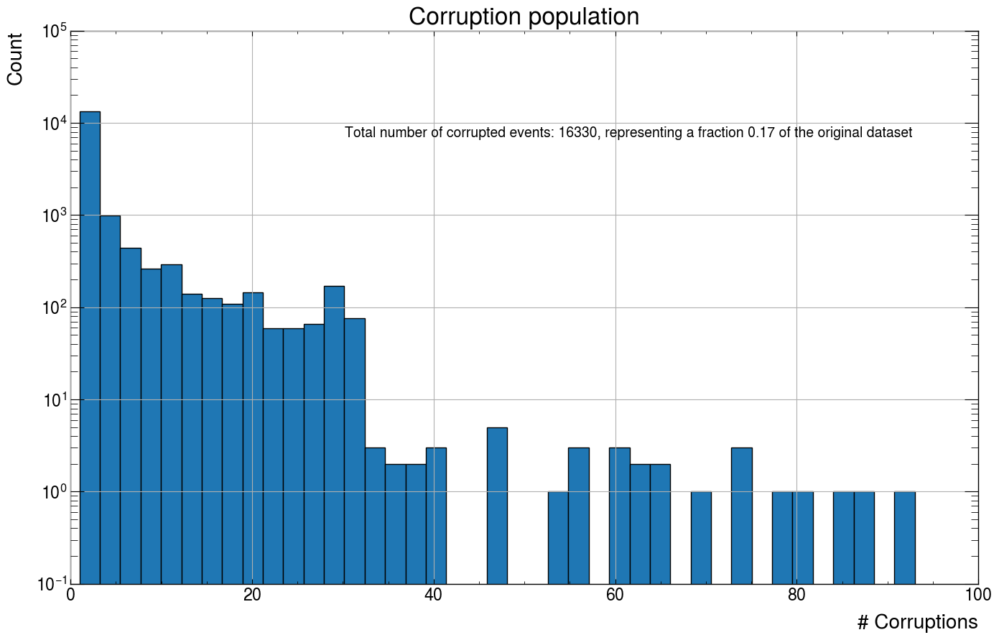

In [25]:
plt.figure(figsize=(16, 10))

# Plot histogram with counts
plt.hist(number_corruptions, bins=41, density=False, edgecolor='black')

# # Set x-ticks spacing to 1
# plt.xticks(np.arange(-20, 21, 2))

plt.annotate(f"Total number of corrupted events: {16330}, representing a fraction {16330/94230:.2f} of the original dataset",(0.3,0.7),xycoords='figure fraction')

# Customize the plot
plt.xlabel('# Corruptions')
plt.ylabel('Count')
plt.title("Corruption population")
plt.yscale('log')
plt.legend()
plt.grid(True)
plt.show()

Removing Corrupted Events leaves 77900/94230, leaving 82% of the original data set. 

In [33]:
print(phiHits[4][1])

[[1285], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]


In [34]:
print(etaHits_uc[4][1])

[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]


In [26]:
#Time_window for coincidence set at 15 ns.
#Temporal Clustering
coincident_hits_ATLAS = ANT.FindCoincidentHits(etaHits_uc,phiHits_uc,15)

#Spatial Clustering
coincident_hits_ATLAS_clustered = ANT.cluster(coincident_hits_ATLAS)

0%
0%
0%
0%
0%
0%
0%


UFuncTypeError: ufunc 'greater' did not contain a loop with signature matching types (<class 'numpy.dtypes.Int64DType'>, <class 'numpy.dtypes.StrDType'>) -> None